In [7]:
import pandas as pd
import os
import glob
import matplotlib.pyplot as plt
from tqdm import tqdm
%run ..\Functions.ipynb

In [8]:
obs_folder=r"..\0_insitu\Data\FLUXNET\FLUXNET2022"
stations_csv = r"..\0_insitu\FLUXNET2022.xlsx"
df_stations = pd.read_excel(stations_csv, index_col=0)
df_stations

,Site,Period,Dataset,x,y,IGBP_site,Climate_site,Climate_KG0p01,Crop type,Irrigation
0,AR-TF1,2016-2018,AMF,-66.733500,-54.973300,WET,0,ET,NaN,NaN
1,CA-Cbo,1994-2020,AMF,-79.933300,44.316700,DBF,Dfb,Dfb,NaN,NaN
2,CA-DB2,2019-2020,AMF,-122.995100,49.119000,WET,0,Csb,NaN,NaN
3,CA-DBB,2014-2020,AMF,-122.984900,49.129300,WET,Csb,Csb,NaN,NaN
4,CA-ER1,2015-2020,AMF,-80.412300,43.640500,CRO,Dfb,Dfb,Corn,NaN
...,...,...,...,...,...,...,...,...,...,...
220,SE-Deg,2001-2020,ICOS-WW,19.557448,64.182333,GRA,NaN,Dfb,NaN,NaN
221,SE-Htm,2015-2020,ICOS-WW,13.417893,56.097566,ENF,Dfb,Dfc,NaN,NaN
222,SE-Nor,2014-2020,ICOS-WW,17.478520,60.086990,ENF,Dfb,Dfb,NaN,NaN
223,SE-Ros,2014-2020,ICOS-WW,19.738000,64.172500,ENF,NaN,Dfb,NaN,NaN


# Add WaPORv3L1 pixel column

In [7]:
# define product time-series
product='WaPORv3L1'
fh_product=r'../0_RS-data/Data/FLUXNET2022_L1_AETI_D.csv'
df_product = pd.read_csv(fh_product,index_col=0,parse_dates=True)

In [8]:
# add time-series of RS product as a new column
for i,row in df_stations.iterrows():
    site=row['Site']
    obs_fh = os.path.abspath(os.path.join(obs_folder,site+".csv"))
    try:
        df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
        df_obs[product]=df_product[site] #add product data to new column
        df_obs.to_csv(obs_fh)
    except:
        print(f'obs_fh does not exsit for {site}: {obs_fh}')

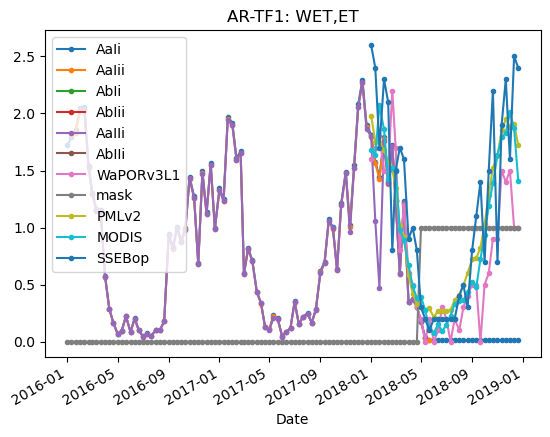

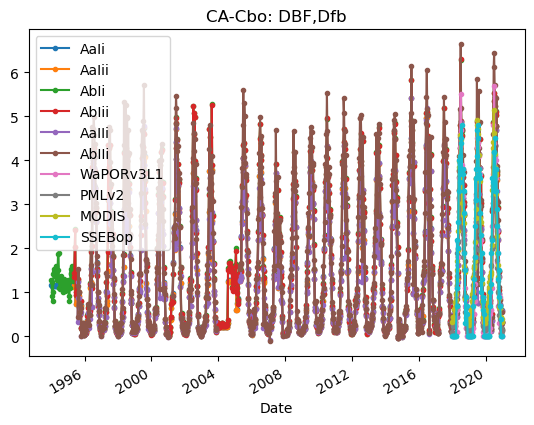

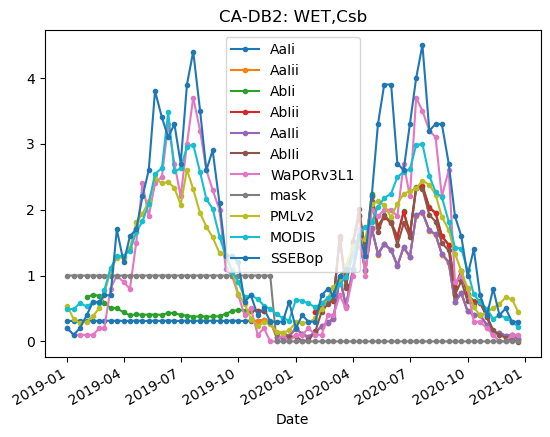

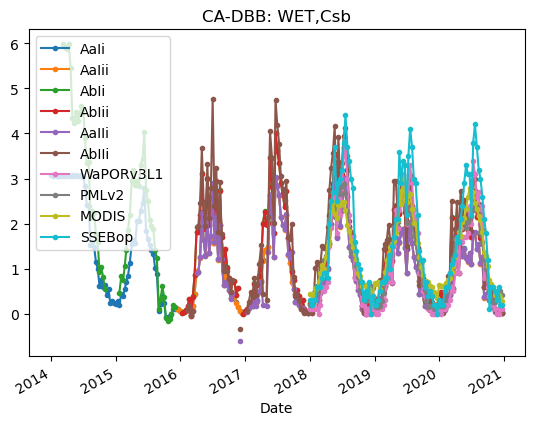

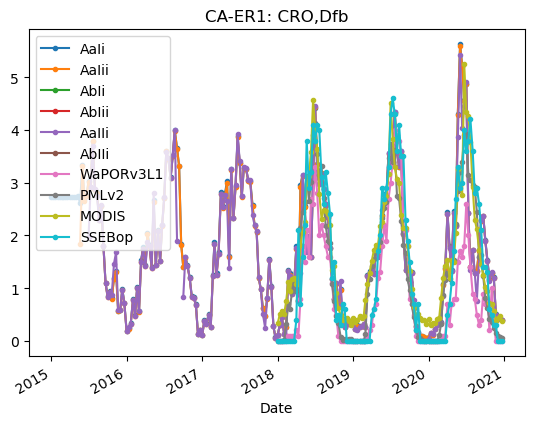

...

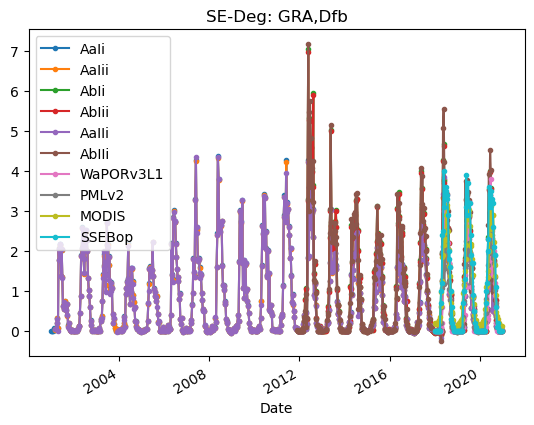

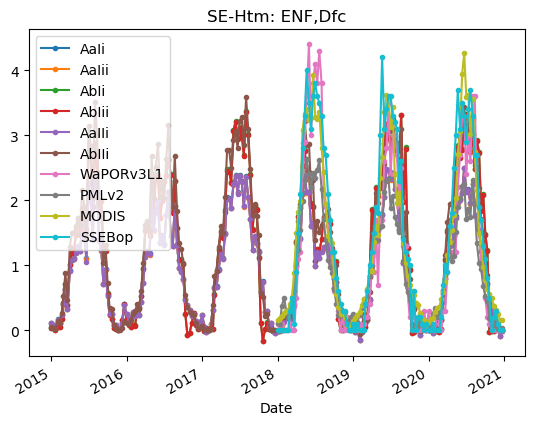

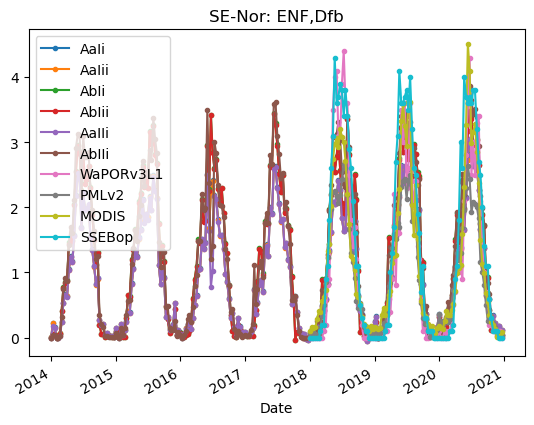

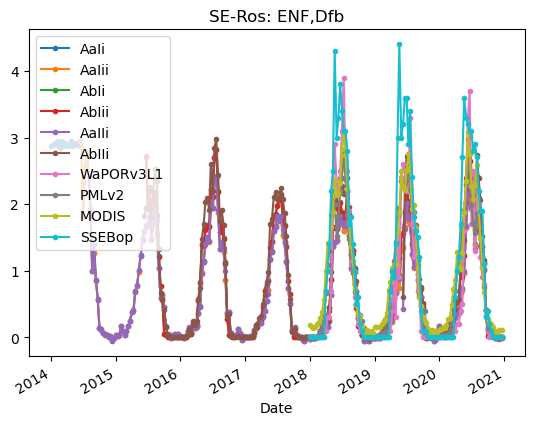

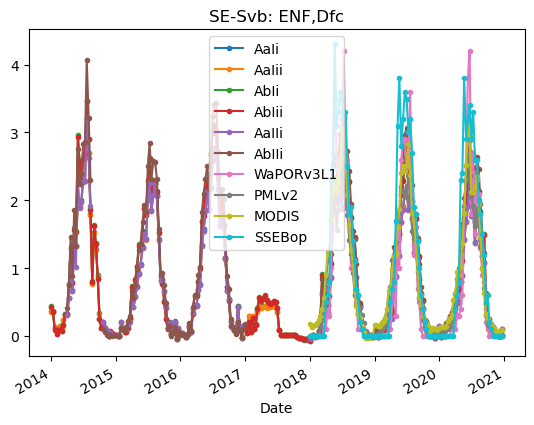

In [9]:
# plot 2 datasets
for i,row in df_stations.iterrows():
    site=row['Site']
    LCC = row['IGBP_site']
    Climate = row['Climate_KG0p01']
    obs_fh = os.path.join(obs_folder,site+".csv")
    try:
        df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
        df_obs.plot(style='.-')
        plt.title(f'{site}: {LCC},{Climate}')
        plt.savefig(f'Site_time-series/{site}.png',bbox_inches='tight')
        plt.show()
    except:
        print(f'obs_fh does not exsit for {site}')

# Visualize interactive time-series to identify periods with erroneous values

In [3]:
import plotly.offline as pyo
pyo.init_notebook_mode(connected=True)

In [8]:
site = 'NL-Loo'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
fig = df_obs.plot(backend='plotly')  # pandas→Plotly
# fig.show(renderer='notebook')     # classic widget
# or
fig.show(renderer='iframe')       # embedded HTML

# Data mask (applied)

Mask static errors from visual assessment

In [155]:
site = 'FR-Gri'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-01-01", "2018-08-21"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [152]:
site = 'FI-Qvd'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-01-01", "2018-04-21"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [149]:
site = 'DK-Gds'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2020-01-01", "2020-07-11"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [144]:
site = 'CH-Aws'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2010-01-01", "2017-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [141]:
site = 'BE-Dor'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2019-01-01", "2020-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [138]:
site = 'DE-Akm'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2009-01-01", "2017-12-31"
df_obs.loc[start:end, 'mask'] = 1
start, end = "2018-11-11", "2020-01-11"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [135]:
site = 'CH-Aws'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2010-01-01", "2017-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [134]:
site = 'AU-Wom'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2021-05-21", "2021-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [131]:
site = 'AU-Whr'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2017-09-21", "2019-03-21"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [128]:
site = 'AU-Lon'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-01-01", "2018-10-01"
df_obs.loc[start:end, 'mask'] = 1
start, end = "2022-06-11", "2022-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [125]:
site = 'US-xYE'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-01-01", "2018-12-11"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [122]:
site = 'US-xSJ'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2019-01-01", "2019-03-01"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [119]:
site = 'US-xSE'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-12-01", "2019-03-11"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [116]:
site = 'US-xSC'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2019-01-01", "2020-06-01"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [112]:
site = 'US-xSB'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2017-01-01", "2019-06-01"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [109]:
site = 'US-xML'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2017-01-01", "2019-02-11"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [106]:
site = 'US-xMB'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2017-01-01", "2018-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [105]:
site = 'US-xHE'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2019-11-01", "2020-05-21"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [104]:
site = 'US-xGR'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2017-01-01", "2017-09-21"
df_obs.loc[start:end, 'mask'] = 1
start, end = "2018-04-01", "2019-01-21"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [103]:
site = 'US-xDS'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2017-01-01", "2018-11-21"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [102]:
site = 'US-xCL'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2017-01-01", "2018-07-21"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [101]:
site = 'US-xBL'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2019-01-01", "2019-07-11"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [100]:
site = 'US-xAE'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2017-01-01", "2019-01-01"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [98]:
site = 'US-xAB'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2019-01-01", "2020-07-21"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [97]:
site = 'US-Tw5'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-01-01", "2018-04-21"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [96]:
site = 'US-Tw4'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2021-08-01", "2021-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [95]:
site = 'US-Tw3'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-06-11", "2018-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [94]:
site = 'US-Snf'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-01-11", "2018-07-11"
df_obs.loc[start:end, 'mask'] = 1
start, end = "2020-08-01", "2020-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [93]:
site = 'US-RGo'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2021-01-01", "2021-06-11"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [92]:
site = 'US-RGA'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2021-01-01", "2021-04-30"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [41]:
site = 'US-NC3'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2021-01-01", "2021-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [38]:
site = 'US-Me6'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2021-07-01", "2021-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [35]:
site = 'US-KS3'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-01-01", "2018-04-11"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [32]:
site = 'US-HWB'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-09-01", "2018-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [29]:
site = 'US-GLE'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2020-10-11", "2020-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [26]:
site = 'US-EML'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2020-05-01", "2020-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [23]:
site = 'US-EDN'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-01-01", "2018-04-01"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [20]:
site = 'US-DS3'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2021-01-01", "2021-07-01"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [17]:
site = 'US-DFC'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-01-01", "2018-10-01"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [14]:
site = 'US-CS4'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2020-01-01", "2020-05-21"
df_obs.loc[start:end, 'mask'] = 1
start, end = "2021-06-01", "2021-10-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [ ]:
site = 'US-CS3'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2019-01-01", "2019-05-01"
df_obs.loc[start:end, 'mask'] = 1
start, end = "2020-05-11", "2020-12-31"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [23]:
site = 'US-CS2'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
df_obs['mask'] = 0
start, end = "2018-01-01", "2018-09-21"
df_obs.loc[start:end, 'mask'] = 1
start, end = "2021-10-01", "2022-01-01"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [18]:
site = 'US-CS1'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)

start, end = "2018-01-01", "2018-07-10"
df_obs['mask'] = 0
df_obs.loc[start:end, 'mask'] = 1
start, end = "2019-05-01", "2020-01-01"
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [17]:
site = 'US-ALQ'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)

start, end = "2018-01-01", "2018-09-21"
df_obs['mask'] = 0
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [14]:
site = 'CA-LP1'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)

start, end = "2018-01-01", "2018-10-31"
df_obs['mask'] = 0
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [7]:
site = 'CA-DB2'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)

start, end = "2019-01-01", "2019-11-30"
df_obs['mask'] = 0
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [ ]:
site = 'CA-DB2'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)

start, end = "2019-01-01", "2019-11-30"
df_obs['mask'] = 0
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

In [18]:
site = 'AR-TF1'
obs_fh = os.path.join(obs_folder,site+".csv")
df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)

start, end = "2018-05-01", "2018-12-21"
df_obs['mask'] = 0
df_obs.loc[start:end, 'mask'] = 1
df_obs.to_csv(obs_fh)

# Add PMLv2 column

In [14]:
# define product time-series
product='PMLv2'
fh_product=r'../0_RS-data/Data/FLUXNET2022_PMLv2_pts.csv'
df_product = pd.read_csv(fh_product,index_col=0,parse_dates=True)

In [15]:
# add time-series of RS product as a new column
for i,row in df_stations.iterrows():
    site=row['Site']
    obs_fh = os.path.abspath(os.path.join(obs_folder,site+".csv"))
    try:
        df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
        df_obs[product]=df_product[site] #add product data to new column
        df_obs.to_csv(obs_fh)
    except:
        print(f'obs_fh does not exsit for {site}: {obs_fh}')

# Add MODIS column

In [16]:
# define product time-series
product='MODIS'
fh_product=r'../0_RS-data/Data/FLUXNET2022_MOD16A2GF_pts.csv'
df_product = pd.read_csv(fh_product,index_col=0,parse_dates=True)

In [17]:
# add time-series of RS product as a new column
for i,row in df_stations.iterrows():
    site=row['Site']
    obs_fh = os.path.abspath(os.path.join(obs_folder,site+".csv"))
    try:
        df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
        df_obs[product]=df_product[site] #add product data to new column
        df_obs.to_csv(obs_fh)
    except:
        print(f'obs_fh does not exsit for {site}: {obs_fh}')

# Add SSEbop column

In [18]:
# define product time-series
product='SSEBop'
fh_product=r'../0_RS-data/Data/FLUXNET2022_SSEBopv61_pts.csv'
df_product = pd.read_csv(fh_product,index_col=0,parse_dates=True)

In [19]:
# add time-series of RS product as a new column
for i,row in df_stations.iterrows():
    site=row['Site']
    obs_fh = os.path.abspath(os.path.join(obs_folder,site+".csv"))
    try:
        df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
        df_obs[product]=df_product[site] #add product data to new column
        df_obs.to_csv(obs_fh)
    except:
        print(f'obs_fh does not exsit for {site}: {obs_fh}')

# Add WaPORv3L1 100ts column

In [3]:
# define product time-series
product='WaPORv3L1-100m'
fh_product=r'../0_RS-data/Data/FLUXNET2022_WaPORv3L1_100m-ts.csv'
df_product = pd.read_csv(fh_product,index_col=0,parse_dates=True)

In [4]:
# add time-series of RS product as a new column
for i,row in df_stations.iterrows():
    site=row['Site']
    obs_fh = os.path.abspath(os.path.join(obs_folder,site+".csv"))
    try:
        df_obs = pd.read_csv(obs_fh, parse_dates=True,index_col=0)
        df_obs[product]=df_product[site] #add product data to new column
        df_obs.to_csv(obs_fh)
    except:
        print(f'obs_fh does not exsit for {site}: {obs_fh}')